#Part 1: Pre-process the documents

---



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# if you do not have 'nltk', the following command should work "python -m pip install nltk"
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
from collections import defaultdict
from array import array
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords
import math
import numpy as np
import collections
from numpy import linalg as la
import time
import json
import re
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import string

1. import the tweets and the doc ids to map them

In [ ]:
tweets_path = '/content/drive/Shareddrives/IRWA/IRWA_data_2024/data/farmers-protest-tweets.json'
with open(tweets_path) as fp:
    tweets = fp.readlines()
tweets = [l.strip().replace(' +', ' ') for l in tweets]
for i in range(len(tweets)):
  tweets[i] = json.loads(tweets[i])

docs_path = '/content/drive/Shareddrives/IRWA/IRWA_data_2024/data/tweet_document_ids_map.csv'
with open(docs_path) as fp:
    doc_id = fp.readlines()
doc_id = [l.strip().replace(' +', ' ') for l in doc_id]
for i in range(len(doc_id)):
  doc_id[i]=doc_id[i].split(",")

#Tweet | Date | Hashtags| Likes | Retweets | Url keep the elements we will show the user when they have the query
keys_to_keep=["url", "date", "content", "id", "retweetCount", "likeCount"]
tweets_values_to_keep=[]
for x in tweets:
  new_dict ={k: x[k] for k in x.keys() & keys_to_keep }
  tweets_values_to_keep.append(new_dict)

#map the tweet ids to the doc id
id_to_doc = {row[1]: row[0] for row in doc_id[1:]}

tweets_values_to_keep = [
    tweets_values_to_keep[i] for i in range(len(tweets_values_to_keep))
    if str(tweets_values_to_keep[i]['id']) in id_to_doc  # Keep only if id exists in doc_id
]

for i in range(len(tweets_values_to_keep)):
  tweets_values_to_keep[i]['id'] = id_to_doc.get(str(tweets_values_to_keep[i]['id']), tweets_values_to_keep[i]['id'])

FUNCTIONS

In [ ]:
def remove_emojis(text):

    emoji_pattern = re.compile(
        "["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U00002702-\U000027B0"  # Dingbats
        u"\U000024C2-\U0001F251"  # Enclosed characters
        "]+", flags=re.UNICODE
    )
    return emoji_pattern.sub(r' ', text)  # Replace emojis by an empty string

def preprocess_tweet(tweet_dict):

  for i in range(len(tweet_dict)):
    tweet_content = tweets_values_to_keep[i]['content']

    hashtags = [tag[1:] for tag in re.findall(r'#\w+', tweet_content) for _ in range(3)]  # Remove the '#' symbol


    cleaned_content = re.sub(r'@\w+', '', tweet_content)  # Remove mentions
    cleaned_content = re.sub(r'#\w+', '', cleaned_content)  # Remove hashtags
    cleaned_content = re.sub(r'http\S+', '', cleaned_content)  # Remove URLs
    cleaned_content = re.sub(r'\s+', ' ', cleaned_content).strip()  # Remove extra spaces
    cleaned_content = remove_emojis(cleaned_content)


    tweet_dict[i]['content'] = cleaned_content
    tweet_dict[i]['hashtags'] = hashtags

  return tweet_dict

def build_terms(line):

    stemmer = PorterStemmer()
    stop_words = set(stopwords.words("english"))
    ## START CODE

    line=  line.lower() ## Transform in lowercase
    line = re.sub(r'[{}]'.format(string.punctuation), '', line) # Remove punctuation
    line=  line.split() ## Tokenize the text to get a list of terms
    line=[word for word in line if word not in stop_words]  ##eliminate the stopwords (HINT: use List Comprehension) for each word in line that we have from split, if it's not in stop words we keep it
    line=[stemmer.stem(word) for word in line] ## perform stemming (HINT: use List Comprehension) apply stem to the stemmer for each word in line
    ## END CODE
    return line

def combine_content_and_hashtags(tweet_dict_list):
    combined_entries = []
    doc_ids=[]

    for tweet in tweet_dict_list:
        # Join hashtags into a single string
        hashtags_str = ' '.join(tweet['hashtags'])  # Combine all hashtags into a single space-separated string
        combined_string = tweet['content'] + " " + hashtags_str  # Concatenate content and hashtags
        combined_entries.append(combined_string)  # Add to the list
        doc_ids.append(tweet['id'])
    return combined_entries, doc_ids


Remove mentions/ hashtags/ url and extra spaces from content and separate hashtags as an entry in the dictionary without the symbol #

In [ ]:
tweets_separated_info=preprocess_tweet(tweets_values_to_keep)


In [ ]:
tweets_separated_info[0]

{'retweetCount': 0,
 'likeCount': 0,
 'content': 'The world progresses while the Indian police and Govt are still trying to take India back to the horrific past through its tyranny. Shame on you.',
 'date': '2021-02-24T09:23:35+00:00',
 'id': 'doc_0',
 'url': 'https://twitter.com/ArjunSinghPanam/status/1364506249291784198',
 'hashtags': ['ModiDontSellFarmers',
  'ModiDontSellFarmers',
  'ModiDontSellFarmers',
  'FarmersProtest',
  'FarmersProtest',
  'FarmersProtest',
  'FreeNodeepKaur',
  'FreeNodeepKaur',
  'FreeNodeepKaur']}

# Part 2: Indexing and Evaluation

#2. Indexing


1. Build inverted index: After having pre-processed the data, you can then create the inverted index

In [ ]:
#without position
def create_index(tweets_separated_info):
    index = defaultdict(list)
    preprocess_tweets, doc_ids=combine_content_and_hashtags(tweets_separated_info)
    for i in range(len(preprocess_tweets)):
      page_id= doc_ids[i]
      terms= build_terms(preprocess_tweets[i])
      current_page_index = {}

      for term in enumerate(terms): # terms contains page_title + page_text. Loop over all terms
            current_page_index[term]=page_id #'I' indicates unsigned int (int in Python), add the id of the doc and the position
        #merge the current page index with the main index
      for term_page, posting_page in current_page_index.items():
        index[term_page].append(posting_page)

        ## END CODE

    return index

In [ ]:
#with position
def create_index(tweets_separated_info):
    index = defaultdict(list)
    preprocess_tweets, doc_ids=combine_content_and_hashtags(tweets_separated_info)
    for i in range(len(preprocess_tweets)):
      page_id= doc_ids[i]
      terms= build_terms(preprocess_tweets[i])
      current_page_index = {}

      for position, term in enumerate(terms): # terms contains page_title + page_text. Loop over all terms
            try:
                # if the term is already in the index for the current page (current_page_index)
                # append the position to the corresponding list

        ## START CODE
                current_page_index[term][1].append(position) #we append the position of the term on the second position of the array, firts position is for document
            except:
                # Add the new term as dict key and initialize the array of positions and add the position
                current_page_index[term]=[page_id, array('I',[position])] #'I' indicates unsigned int (int in Python), add the id of the doc and the position
        #merge the current page index with the main index
      for term_page, posting_page in current_page_index.items():
        index[term_page].append(posting_page)

        ## END CODE

    return index

In [ ]:
def create_index_tfidf(tweets_separated_info, num_documents):
    index = defaultdict(list)
    tf = defaultdict(list)  # Term frequencies of terms in documents
    df = defaultdict(int)  # Document frequencies of terms in the corpus
    idf = defaultdict(float)

    # Preprocess tweets and combine content/hashtags
    preprocess_tweets, doc_ids = combine_content_and_hashtags(tweets_separated_info)

    for i, terms_content in enumerate(preprocess_tweets):
        page_id = doc_ids[i]
        terms = build_terms(terms_content)
        current_page_index = defaultdict(lambda: [page_id, array('I')])

        # Populate current_page_index with term positions
        for position, term in enumerate(terms):
            current_page_index[term][1].append(position)

        # Calculate normalization factor (norm)
        norm = math.sqrt(sum(len(posting[1]) ** 2 for posting in current_page_index.values()))

        # Calculate term frequencies (tf) and document frequencies (df)
        for term, posting in current_page_index.items():
            tf[term].append(len(posting[1]) / norm)
            df[term] += 1

        # Merge current page index with the main index
        for term, posting in current_page_index.items():
            index[term].append(posting)

    # Compute IDF values using vectorized operations
    for term, doc_freq in df.items():
        idf[term] = np.log(num_documents / doc_freq)

    return index, tf, df, idf, tweets_separated_info




In [ ]:
index=create_index(tweets_separated_info)

In [ ]:
num_documents = len(tweets_separated_info)
index, tf, df, idf, title_index= create_index_tfidf(tweets_separated_info, num_documents)

In [ ]:
print(tf)
print(idf)

defaultdict(<class 'list'>, {'world': [0.15617376188860607, 0.2, 0.12126781251816648, 0.1643989873053573, 0.09950371902099892, 0.13736056394868904, 0.21320071635561041, 0.14744195615489714, 0.20412414523193154, 0.17149858514250882, 0.15811388300841897, 0.18257418583505536, 0.11624763874381928, 0.14586499149789456, 0.22941573387056174, 0.1889822365046136, 0.13736056394868904, 0.1796053020267749, 0.2, 0.19245008972987526, 0.1889822365046136, 0.1690308509457033, 0.16012815380508713, 0.15075567228888181, 0.14285714285714285, 0.16012815380508713, 0.22360679774997896, 0.30151134457776363, 0.19245008972987526, 0.2773500981126146, 0.20412414523193154, 0.16666666666666666, 0.16222142113076254, 0.17149858514250882, 0.18569533817705186, 0.17149858514250882, 0.2, 0.17677669529663687, 0.14907119849998599, 0.15811388300841897, 0.20851441405707477, 0.18257418583505536, 0.08247860988423225, 0.1643989873053573, 0.17149858514250882, 0.15249857033260467, 0.1889822365046136, 0.2773500981126146, 0.19245008

In [ ]:
print(num_documents)

48429


In [ ]:
print(index)

defaultdict(<class 'list'>, {'world': [['doc_0', array('I', [0])], ['doc_38', array('I', [10])], ['doc_52', array('I', [7])], ['doc_86', array('I', [6])], ['doc_111', array('I', [8])], ['doc_143', array('I', [0])], ['doc_187', array('I', [3])], ['doc_248', array('I', [13])], ['doc_252', array('I', [2])], ['doc_336', array('I', [8])], ['doc_460', array('I', [3])], ['doc_508', array('I', [7])], ['doc_519', array('I', [22])], ['doc_689', array('I', [4])], ['doc_751', array('I', [9])], ['doc_913', array('I', [0])], ['doc_926', array('I', [4])], ['doc_997', array('I', [12])], ['doc_1057', array('I', [4])], ['doc_1059', array('I', [4])], ['doc_1066', array('I', [7])], ['doc_1159', array('I', [7])], ['doc_1262', array('I', [12])], ['doc_1346', array('I', [9])], ['doc_1377', array('I', [2])], ['doc_1451', array('I', [6])], ['doc_1479', array('I', [0])], ['doc_1502', array('I', [0])], ['doc_1538', array('I', [0])], ['doc_1563', array('I', [1])], ['doc_1570', array('I', [2])], ['doc_1599', array

In [ ]:
def rank_documents(terms, docs, index, idf, tf, title_index):

    # I'm interested only on the element of the docVector corresponding to the query terms
    # The remaining elements would became 0 when multiplied to the query_vector
    doc_vectors = defaultdict(lambda: [0] * len(terms)) # I call doc_vectors[k] for a nonexistent key k, the key-value pair (k,[0]*len(terms)) will be automatically added to the dictionary
    query_vector = [0] * len(terms)

    # compute the norm for the query tf
    query_terms_count = collections.Counter(terms)  # get the frequency of each term in the query.

    query_norm = la.norm(list(query_terms_count.values()))

    for termIndex, term in enumerate(terms):  #termIndex is the index of the term in the query
        if term not in index:
            continue

        ## Compute tf*idf(normalize TF as done with documents)
        query_vector[termIndex]=query_terms_count[term]/query_norm * idf[term] #frequency of term normalized *idf of the term

        # Generate doc_vectors for matching docs
        for doc_index, (doc, postings) in enumerate(index[term]):

            #tf[term][0] will contain the tf of the term "term" in the doc 26
            if doc in docs:
                doc_vectors[doc][termIndex] = tf[term][doc_index] * idf[term]

    # Calculate the score of each doc with cosine similarity
    doc_scores=[[np.dot(curDocVec, query_vector), doc] for doc, curDocVec in doc_vectors.items() ]
    doc_scores.sort(reverse=True)
    result_docs = [x[1] for x in doc_scores]

    if len(result_docs) == 0:
        print("No results found, try again")
        query = input()
        docs = search_tf_idf(query, index)

    return result_docs

In [ ]:
def search_tf_idf(query, index):
    """
    output is the list of documents that contain any of the query terms.
    So, we will get the list of documents for each query term, and take the union of them.
    """
    query = build_terms(query)
    docs = set()
    for term in query:
        try:
            # store in term_docs the ids of the docs that contain "term"
            term_docs=[posting[0] for posting in index[term]]

            # docs = docs Union term_docs
            docs = docs.union(set(term_docs))
        except:
            #term is not in index
            pass
    docs = list(docs)
    ranked_docs = rank_documents(query, docs, index, idf, tf, title_index)
    return ranked_docs

2. Propose test queries:
we extract the top 20 most frequent words (or hashtags) to create our queries

In [ ]:
# Calculate frequency of each word
word_frequencies = {word: sum(len(occurrence[1]) for occurrence in occurrences) for word, occurrences in index.items()}

# Get the 10 most frequent words
most_frequent_words = sorted(word_frequencies, key=word_frequencies.get, reverse=True)[:20]

print(most_frequent_words)

['farmersprotest', 'farmer', 'india', 'releasedetainedfarm', 'indiabeingsilenc', 'farmersmakeindia', 'disharavi', 'support', 'mahapanchayatrevolut', 'repealonlywayahead', 'protest', 'pagdisambhaljatta', 'amp', 'standwithfarm', 'modiignoringfarmersdeath', 'railrokoforfarm', 'istandwithfarm', 'msplawforallcrop', 'modi', 'freenodeepkaur']


3. Rank your results:

In [ ]:
query_list = ["Farmers protest", "Farmers rights", "India is being silenced", "Detained farmers", "Support farmers revolution"]
query_results = {query: [] for query in query_list}

for query in query_list:
  ranked_docs = search_tf_idf(query, index)
  query_results[query].append(ranked_docs)
  top = 10

  print("\n======================\nTop {} results out of {} for the searched query {}:\n".format(top, len(ranked_docs), query))
  for d_id in ranked_docs[:top]:

    int_value = int(d_id.split('_')[1])
    print("doc_id= {} - tweet: {}".format(d_id, title_index[int_value]))

  print("\n")


Top 10 results out of 15716 for the searched query Farmers protest:

doc_id= doc_25479 - tweet: {'retweetCount': 0, 'likeCount': 1, 'content': 'Peaceful protester playing with police in border', 'date': '2021-02-17T04:10:59+00:00', 'id': 'doc_25479', 'url': 'https://twitter.com/yedhu_pillai/status/1361890866047033345', 'hashtags': ['Singhu', 'Singhu', 'Singhu', 'FarmersProtest', 'FarmersProtest', 'FarmersProtest', 'protest', 'protest', 'protest']}
doc_id= doc_445 - tweet: {'retweetCount': 0, 'likeCount': 1, 'content': "Farmers Protest | Pawri Ho Rahi Hai   Dedicated to The 2020–2021 Indian farmers' protest. \u200b is an ongoing protest against three farm acts which were passed by the Parliament of India in Sep 2020. Millions of farmers are protesting in India.", 'date': '2021-02-24T05:44:59+00:00', 'id': 'doc_445', 'url': 'https://twitter.com/IamGDhillon/status/1364451234204291073', 'hashtags': ['FarmersProtest', 'FarmersProtest', 'FarmersProtest']}
doc_id= doc_40148 - tweet: {'retwee

#3. Evaluation

Evaluation techniques (Precision, Recall, Average precision, F1-score, Mean Average Precisio (MAP), Mean Reciprocal Rank (MRR), Normalized Discout Cumulative Gain (NDCG))

In [ ]:
def precision_at_k(doc_score, y_score, k=10):
    """
    Parameters
    ----------
    doc_score: Ground truth (true relevance labels).
    y_score: Predicted scores.
    k : number of doc to consider.

    Returns
    -------
    precision @k : float

    """
    order = np.argsort(y_score)[::-1]
    doc_score = np.take(doc_score, order[:k])
    #doc_score = doc_score[order[:k]]
    relevant = sum(doc_score == 1)
    return float(relevant) / k

def recall_at_k(y_true, y_score, k=10):
    """
    Calculates the recall@k metric.

    Args:
        y_true: A list of true relevance labels (0 or 1).
        y_score: A list of predicted relevance scores.
        k: The number of top-ranked documents to consider.

    Returns:
        The recall@k value.
    """
    # Sort documents by predicted relevance scores in descending order
    ranked_documents = sorted(range(len(y_score)), key=lambda i: y_score[i], reverse=True)

    # Calculate the number of relevant documents in the top-k
    relevant_in_top_k = sum(y_true[i] for i in ranked_documents[:k])

    # Calculate the total number of relevant documents
    total_relevant = sum(y_true)

    # Handle cases with no relevant documents to avoid division by zero
    if total_relevant == 0:
      return 0.0

    # Calculate recall@k
    recall = relevant_in_top_k / total_relevant

    return recall

def avg_precision_at_k(y_true, y_score, k=10):
    """
    Parameters
    ----------
    y_true: Ground truth (true relevance labels).
    y_score: Predicted scores.
    k : number of doc to consider.

    Returns
    -------
    average precision @k : float
    """

    order = np.argsort(y_score)[::-1]  # get the list of indexes of the predicted score sorted in descending order.

    prec_at_i = 0
    prec_at_i_list = []
    number_of_relevant = 0
    number_to_iterate = min(k, len(order))

    for i in range(number_to_iterate):
        if y_true[order[i]] == 1:
            number_of_relevant += 1
            prec_at_i = number_of_relevant / (i + 1)
            prec_at_i_list.append(prec_at_i)

    if number_of_relevant == 0:
        return 0
    else:
      return np.sum(prec_at_i_list) / number_of_relevant

def f1_score(precision, recall):
  return (2*(precision*recall))/(precision+recall)

def map_at_k(search_res, k=10):
    '''
    Parameters
    ----------
    search_res: search results dataset containing:
        q_id: query id.
        doc_id: document id.
        predicted_relevance: relevance predicted through LightGBM.
        y_true: actual score of the document for the query (ground truth).

    Returns
    -------
    mean average precision @k : float
    '''
    avp = []
    for q in search_res["query_id"].unique():  #loop over all query id
        curr_data = search_res[search_res["query_id"] == q]  # select data for current query
        avp.append(avg_precision_at_k(np.array(curr_data["bin_y_true"]), np.array(curr_data["predicted_relevance"]),
                                      k))  #append average precision for current query
    return np.sum(avp) / len(avp), avp  # return mean average precision

def rr_at_k(y_true, y_score, k=10):
    """
    Parameters
    ----------
    y_true: Ground truth (true relevance labels).
    y_score: Predicted scores.
    k : number of doc to consider.

    Returns
    -------
    Reciprocal Rank for qurrent query
    """


    order = np.argsort(y_score)[::-1] # get the list of indexes of the predicted score sorted in descending order.
    y_true = np.take(y_true, order[:k])
    #y_true = y_true[order[:k]] # sort the actual relevance label of the documents based on predicted score(hint: np.take) and take first k.
    if np.sum(y_true) == 0: # if there are not relevant doument return 0
        return 0
    return 1/(np.argmax(y_true)+1) # hint: to get the position of the first relevant document use "np.argmax"

def dcg_at_k(y_true, y_score, k=10):
    order = np.argsort(y_score)[::-1]  # get the list of indexes of the predicted score sorted in descending order.
    y_true = np.take(y_true, order[:k])  # sort the actual relevance label of the documents based on predicted score(hint: np.take) and take first k.
    gain = 2 ** y_true - 1  # Compute gain (use formula 7 above)
    discounts = np.log2(np.arange(len(y_true)) + 2)  # Compute denominator
    return np.sum(gain / discounts)  #return dcg@k


def ndcg_at_k(y_true, y_score, k=10):
    dcg_max = dcg_at_k(y_true, y_true, k)
    if not dcg_max:
        return 0
    return np.round(dcg_at_k(y_true, y_score, k) / dcg_max, 4)

In [ ]:
ground_truth = {
    "Farmers protest": [1,0,1,0,0,1,0,0,1,0],
    "Farmers rights": [0,1,0,1,0,0,1,0,0,0],
    "India is being silenced": [0,0,1,0,1,0,1,1,0,1],
    "Detained farmers": [1,0,0,0,1,1,0,1,0,0],
    "Support farmers revolution": [0,1,0,0,1,1,1,0,1,0]
}

# Evaluation metrics for each query
results = {}
k = 10 # Number of top documents to consider

for query, ranked_docs in query_results.items():
  results[query] = {}

  y_true = ground_truth.get(query, []) # Retrieve ground truth for the query. If not present return empty list
  if not y_true:
      print(f"Warning: No ground truth found for query '{query}'. Skipping evaluation.")
      continue

  # Assuming the score is based on the rank, higher rank == higher score
  y_score = list(range(len(ranked_docs[0]), 0, -1))[:k] #create an array where each element is the rank, used as a placeholder for the predicted scores. Replace ranked_docs with your actual scores.


  results[query]['precision@k'] = precision_at_k(np.array(y_true[:k]), np.array(y_score), k=k)
  results[query]['recall@k'] = recall_at_k(np.array(y_true[:k]), np.array(y_score), k=k) / sum(y_true) if sum(y_true)>0 else 0 #Avoiding division by zero
  results[query]['avg_precision@k'] = avg_precision_at_k(np.array(y_true[:k]), np.array(y_score), k=k)
  results[query]['f1_score@k'] = f1_score(results[query]['precision@k'], results[query]['recall@k']) if results[query]['precision@k']+results[query]['recall@k'] > 0 else 0
  results[query]['rr@k'] = rr_at_k(np.array(y_true[:k]), np.array(y_score), k=k)
  results[query]['ndcg@k'] = ndcg_at_k(np.array(y_true[:k]), np.array(y_score), k=k)

  print(f"Metrics for query '{query}': {results[query]}")


# MAP Calculation
map_values = []
for query, metric_values in results.items():
    map_values.append(metric_values['avg_precision@k'])

map_score = np.mean(map_values)

print(f"\nMean Average Precision (MAP): {map_score}")

Metrics for query 'Farmers protest': {'precision@k': 0.4, 'recall@k': 0.25, 'avg_precision@k': 0.6527777777777777, 'f1_score@k': 0.3076923076923077, 'rr@k': 1.0, 'ndcg@k': 0.8421}
Metrics for query 'Farmers rights': {'precision@k': 0.3, 'recall@k': 0.3333333333333333, 'avg_precision@k': 0.4761904761904762, 'f1_score@k': 0.3157894736842105, 'rr@k': 0.5, 'ndcg@k': 0.6546}
Metrics for query 'India is being silenced': {'precision@k': 0.5, 'recall@k': 0.2, 'avg_precision@k': 0.4323809523809524, 'f1_score@k': 0.28571428571428575, 'rr@k': 0.3333333333333333, 'ndcg@k': 0.6189}
Metrics for query 'Detained farmers': {'precision@k': 0.4, 'recall@k': 0.25, 'avg_precision@k': 0.6, 'f1_score@k': 0.3076923076923077, 'rr@k': 1.0, 'ndcg@k': 0.8036}
Metrics for query 'Support farmers revolution': {'precision@k': 0.5, 'recall@k': 0.2, 'avg_precision@k': 0.5053968253968254, 'f1_score@k': 0.28571428571428575, 'rr@k': 0.5, 'ndcg@k': 0.6812}

Mean Average Precision (MAP): 0.5333492063492064


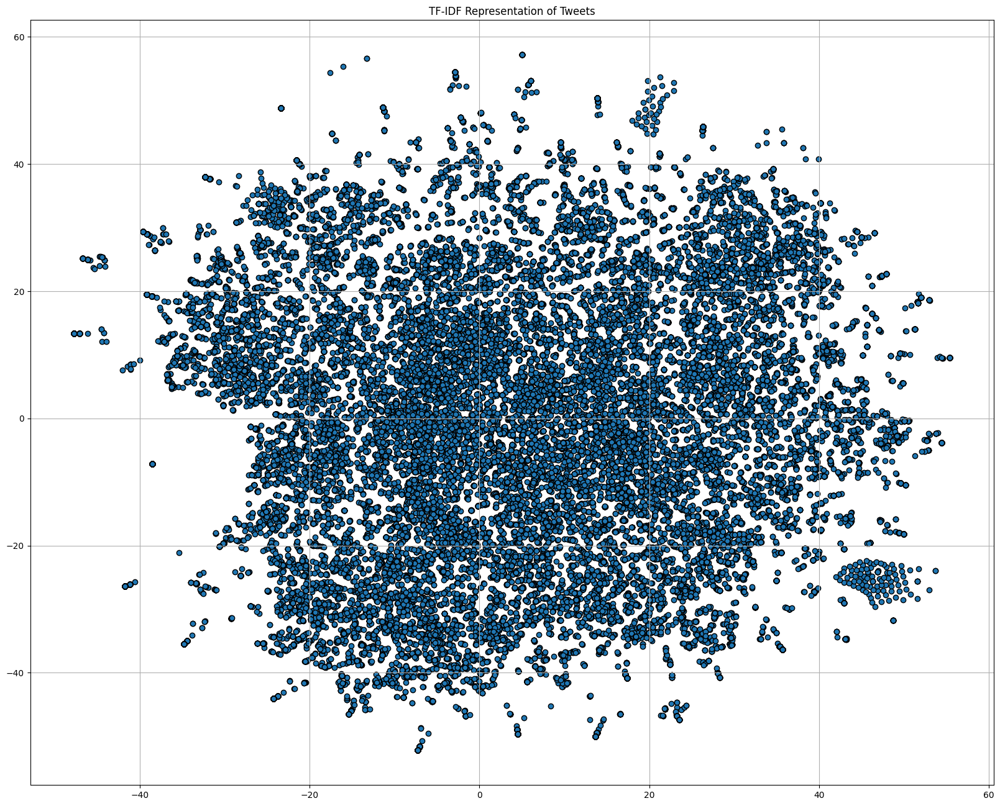

In [ ]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np

tweets_content = [tweet['content'] for tweet in tweets_separated_info]  # Get a list with the content of the tweets

# Use TF-IDF in tweets
tfidf_vectorizer = TfidfVectorizer(max_features=30)  # Limit to top 30 features
tweets_tfidf = tfidf_vectorizer.fit_transform(tweets_content)

# Apply T-SNE
#n_components refers to the number of components we have. Since we are working with a matrix, we have 2 components. max_iter refers to the maximum iterations of optimization of the model
tsne = TSNE(n_components=2, max_iter=500)
tweets_tsne = tsne.fit_transform(tweets_tfidf.toarray())

# 2D scatter plot
plt.figure(figsize=(20, 16)) #Increase the size of the plot
plt.scatter(tweets_tsne[:, 0], tweets_tsne[:, 1], edgecolor='k') #We input the first component of the TSNE as the X-axis and the second component of the TSNE as the Y-axis. We also put the edgecolor to be able to distinguish each tweet
plt.title('TF-IDF Representation of Tweets') #Title of the plot
plt.grid(True) #Enable grid
plt.show() #Show plot

# Part 3: Ranking

# SCORES

1. TF-IDF + cosine similarity

In [ ]:
query_list = ["Farmers protest", "Farmers rights", "India is being silenced", "Detained farmers", "Support farmers revolution"]
query_results = {query: [] for query in query_list}

for query in query_list:
  ranked_docs = search_tf_idf(query, index)
  query_results[query].append(ranked_docs)
  top = 20

  print("\n======================\nTop {} results out of {} for the searched query {}:\n".format(top, len(ranked_docs), query))
  for d_id in ranked_docs[:top]:

    int_value = int(d_id.split('_')[1])
    print("doc_id= {} - tweet: {}".format(d_id, title_index[int_value]))

  print("\n")


Top 20 results out of 15716 for the searched query Farmers protest:

doc_id= doc_25479 - tweet: {'retweetCount': 0, 'likeCount': 1, 'content': 'Peaceful protester playing with police in border', 'date': '2021-02-17T04:10:59+00:00', 'id': 'doc_25479', 'url': 'https://twitter.com/yedhu_pillai/status/1361890866047033345', 'hashtags': ['Singhu', 'Singhu', 'Singhu', 'FarmersProtest', 'FarmersProtest', 'FarmersProtest', 'protest', 'protest', 'protest']}
doc_id= doc_445 - tweet: {'retweetCount': 0, 'likeCount': 1, 'content': "Farmers Protest | Pawri Ho Rahi Hai   Dedicated to The 2020–2021 Indian farmers' protest. \u200b is an ongoing protest against three farm acts which were passed by the Parliament of India in Sep 2020. Millions of farmers are protesting in India.", 'date': '2021-02-24T05:44:59+00:00', 'id': 'doc_445', 'url': 'https://twitter.com/IamGDhillon/status/1364451234204291073', 'hashtags': ['FarmersProtest', 'FarmersProtest', 'FarmersProtest']}
doc_id= doc_40148 - tweet: {'retwee

3. BM25

In [ ]:
def calculate_doc_lengths_and_avg(title_index):

    doc_lengths = {}
    total_length = 0

    # Calculate each document's length and the total length
    for doc in title_index:
        doc_id = doc['id']
        content = doc['content']
        doc_length = len(content.split())  # Number of words in content
        doc_lengths[doc_id] = doc_length
        total_length += doc_length

    # Calculate the average document length
    avg_doc_length = total_length / len(title_index) if title_index else 0

    return doc_lengths, avg_doc_length

doc_lengths, avg_doc_length= calculate_doc_lengths_and_avg(title_index)

In [ ]:
def rank_documents_bm25(terms, docs, index, idf, tf, title_index, doc_lengths, avg_doc_length, k1=1.5, b=0.75):

    doc_scores = defaultdict(float)

    # Iterate over each term in the query
    for termIndex, term in enumerate(terms):
        if term in index:

          for doc_index, (doc, postings) in enumerate(index[term]):
              if doc in docs:

                # Get the term frequency of `term` in the document
                term_frequency = tf[term][doc_index]

                # Document length normalization
                doc_length = doc_lengths[doc]
                norm_term_frequency = ((term_frequency * (k1 + 1)) / (term_frequency + k1 * (1 - b + b * doc_length / avg_doc_length)))

                # Calculate BM25 score component for this term in this document
                doc_scores[doc] += idf[term] * norm_term_frequency

    # Sort documents by score in descending order
    ranked_docs = sorted(doc_scores.items(), key=lambda x: x[1], reverse=True)
    result_docs = [doc for doc, score in ranked_docs]

    return result_docs

In [ ]:
def search_bm25(query, index):
    query = build_terms(query)
    docs = set()
    for term in query:
        try:
            # store in term_docs the ids of the docs that contain "term"
            term_docs=[posting[0] for posting in index[term]]

            # docs = docs Union term_docs
            docs = docs.union(set(term_docs))
        except:
            #term is not in index
            pass
    docs = list(docs)
    # Rank documents using BM25
    ranked_docs = rank_documents_bm25(query, docs, index, idf, tf, title_index, doc_lengths, avg_doc_length)
    return ranked_docs

In [ ]:
for query in query_list:
  ranked_docs = search_bm25(query, index)
  query_results[query].append(ranked_docs)
  top = 20

  print("\n======================\nTop {} results out of {} for the searched query {}:\n".format(top, len(ranked_docs), query))
  for d_id in ranked_docs[:top]:

    int_value = int(d_id.split('_')[1])
    print("doc_id= {} - tweet: {}".format(d_id, title_index[int_value]))

  print("\n")

3. Word2vec + cosine similarity

In [ ]:
import numpy as np
from numpy import linalg as la
import gensim
from gensim.models import Word2Vec

def cosine_similarity(v1, v2):
    """
    Computes the cosine similarity between two vectors.
    """
    dot_product = np.dot(v1, v2)
    norm_v1 = la.norm(v1)
    norm_v2 = la.norm(v2)
    if norm_v1 == 0 or norm_v2 == 0:
        return 0  # Handle cases where either vector has zero magnitude
    else:
        return dot_product / (norm_v1 * norm_v2)

def model_word2vec(docs):
  """Generates the model for word2vec."""
  tweets = [doc['content'] for doc in docs]
  words = [tweet.split() for tweet in tweets]
  model = Word2Vec(sentences=words, workers=4, window=3, min_count=200)
  return model

def tweet2vec(tweet, model):
    """
    Generates a tweet representation (tweet2vec) by averaging word vectors.
    """
    vectors = []
    for word in tweet.split():
        try:
            vectors.append(model.wv[word])
        except KeyError:
            # Handle words not found in the vocabulary (e.g., using a zero vector)
            vectors.append(np.zeros(model.vector_size))

    #Return the avg of the vectors or a zero vector for empty tweets
    if vectors:
        return np.mean(vectors, axis=0)
    else:
      return np.zeros(model.vector_size)

def search_word2vec(query, title_index, top_k=20):
    """
    Ranks documents based on cosine similarity between tweet2vec and query2vec.
    """
    model = model_word2vec(title_index)

    query_vector = tweet2vec(query, model) # Generates a vector representation of the query
    doc_scores = []

    for doc_id in range(len(title_index)):  # Iterate over each document
      tweet = title_index[doc_id]['content'] # Access tweet content
      doc_vector = tweet2vec(tweet, model) # Generates a vector representation of the tweet

      # Computing doc scores based on cosine similarity
      score = cosine_similarity(query_vector, doc_vector)
      doc_scores.append((doc_id, score))

    doc_scores.sort(key=lambda x: x[1], reverse=True)
    ranked_docs = [f"doc_{doc_id}" for doc_id, score in doc_scores[:top_k]]
    return ranked_docs

In [ ]:
for query in query_list:
    ranked_docs = search_word2vec(query, title_index)
    query_results[query].append(ranked_docs)
    top = 20

    print("\n======================\nTop {} results out of {} for the searched query {}:\n".format(top, len(ranked_docs), query))
    for d_id in ranked_docs[:top]:

      int_value = int(d_id.split('_')[1])
      print("doc_id= {} - tweet: {}".format(d_id, title_index[int_value]))

    print("\n")